In [106]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [107]:
import numpy as np
import matplotlib.pyplot as plt
import scipy
from scipy.io import wavfile
from IPython.display import Audio
from scipy import fft
import librosa
import librosa.display
from wavinfo import WavInfoReader
import pandas as pd
import os
import sys
import seaborn as sns

In [108]:
sys.path.insert(0, '/Users/HZB/code/vickoru/drumbeatid')

In [109]:
from drumbeatid import features 

In [110]:
def read_audio(audiofile_path, samplingrate=22050, duration=None):
    '''
    Reading in audiofile, returns 1-dimensional array x, sampling rate sr
    '''

    x , sr = librosa.load(audiofile_path, sr=samplingrate, duration=duration)
    return x, sr


def spectogram(waveform, samplingrate):
    '''
    ===  1 Spectogram  ===
    requires 1-dimensional array x(timeseries), sampling rate sr
    returns spectogram, a matplotlib.colormesh object

    '''

    #performing short time- Fourier analysis
    X = librosa.stft(waveform, samplingrate)

    #amplitudes of given frequency at given time -> spectrogram
    Xdb = librosa.amplitude_to_db(abs(X))

    #plt.figure(figsize=(6, 5), frameon=False)
    #librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz') # for demonstration purposes
    
    spectogram = librosa.display.specshow(Xdb, sr=sr, x_axis=None, y_axis=None) # without axes
    
    return spectogram 

In [111]:
df_drummers = pd.read_csv(os.path.join(loc, 'info.csv'))
df_drummers.sample(10)

,drummer,session,id,style,bpm,beat_type,time_signature,midi_filename,audio_filename,duration,split
579,drummer3,drummer3/session2,drummer3/session2/30,rock,92,beat,4-4,drummer3/session2/30_rock_92_beat_4-4.mid,drummer3/session2/30_rock_92_beat_4-4.wav,9.203806,train
874,drummer7,drummer7/session3,drummer7/session3/107,hiphop,70,fill,4-4,drummer7/session3/107_hiphop_70_fill_4-4.mid,drummer7/session3/107_hiphop_70_fill_4-4.wav,3.400001,validation
2,drummer1,drummer1/eval_session,drummer1/eval_session/2,funk/groove2,105,beat,4-4,drummer1/eval_session/2_funk-groove2_105_beat_...,drummer1/eval_session/2_funk-groove2_105_beat_...,36.351218,test
361,drummer1,drummer1/session2,drummer1/session2/174,afrocuban/rhumba,110,fill,4-4,drummer1/session2/174_afrocuban-rhumba_110_fil...,drummer1/session2/174_afrocuban-rhumba_110_fil...,2.000002,train
568,drummer3,drummer3/session2,drummer3/session2/20,rock,92,beat,4-4,drummer3/session2/20_rock_92_beat_4-4.mid,drummer3/session2/20_rock_92_beat_4-4.wav,36.399461,train
552,drummer3,drummer3/session1,drummer3/session1/6,rock,105,beat,4-4,drummer3/session1/6_rock_105_beat_4-4.mid,drummer3/session1/6_rock_105_beat_4-4.wav,10.152389,train
310,drummer1,drummer1/session2,drummer1/session2/128,afrocuban/bembe,122,fill,4-4,drummer1/session2/128_afrocuban-bembe_122_fill...,drummer1/session2/128_afrocuban-bembe_122_fill...,1.887294,train
96,drummer1,drummer1/session1,drummer1/session1/177,afrocuban,105,fill,4-4,drummer1/session1/177_afrocuban_105_fill_4-4.mid,drummer1/session1/177_afrocuban_105_fill_4-4.wav,2.036903,train
213,drummer1,drummer1/session1,drummer1/session1/40,latin/samba,116,fill,4-4,drummer1/session1/40_latin-samba_116_fill_4-4.mid,drummer1/session1/40_latin-samba_116_fill_4-4.wav,1.862068,train
1136,drummer2,drummer2/session2,drummer2/session2/2,rock,130,beat,4-4,drummer2/session2/2_rock_130_beat_4-4.mid,NaN,18.327866,validation


In [131]:
pwd = os.path.abspath('.')
loc = os.path.join(pwd, '..', 'raw_data', 'groove')
# loc_ = '../raw_data/groove/info.csv'
loc

'/Users/HZB/code/vickoru/drumbeatid/notebooks/../raw_data/groove'

In [132]:
short = [407, 541, 535]
long = [ 13, 14, 1129]

In [133]:
idb = short[1]
drumbeat = df_drummers.loc[idb, 'audio_filename']
wavFile = os.path.join(loc, drumbeat)
duration = None
y_short, sr_short = read_audio(wavFile, duration=duration)
Audio(wavFile)

In [134]:
y_short.shape

(44100,)

In [135]:
sr_short

22050

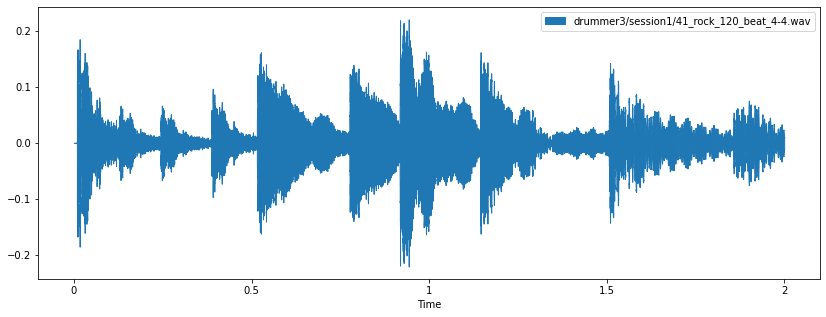

In [136]:
plt.figure(figsize=(14, 5))
librosa.display.waveshow(y_short, sr=sr_short, label=drumbeat)
plt.legend()
plt.savefig('waveform.png')

In [137]:
idb = long[0]
drumbeat = df_drummers.loc[idb, 'audio_filename']
wavFile = os.path.join(loc, drumbeat)
duration = 6
y_long, sr_long = read_audio(wavFile, duration=duration)
Audio(wavFile)

In [138]:
y_long.shape

(132300,)

In [139]:
sr_long*(20)

441000

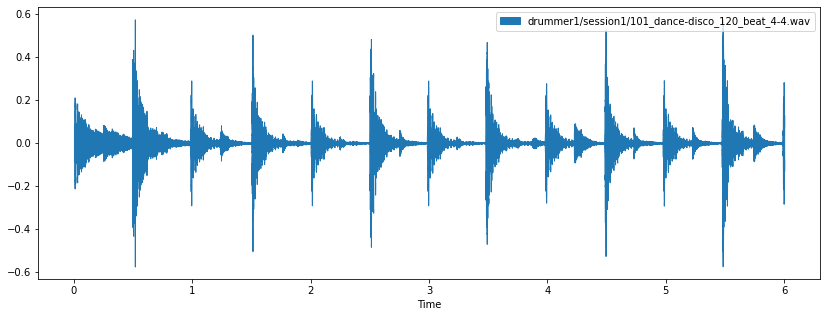

In [140]:
plt.figure(figsize=(14, 5))
librosa.display.waveshow(y_long, sr=sr_long, label=drumbeat)
plt.legend()
plt.savefig('waveform.png')

In [141]:
mfccs_short = features.calculate_mfccs(y_short, sr_short)
print(mfccs_short.shape)
mfccs_short

(20, 87)


array([[-1.80500076e+02, -1.33065643e+02, -1.57843964e+02, ...,
        -3.96301697e+02, -4.22246399e+02, -4.42577881e+02],
       [ 9.16556396e+01,  7.86529846e+01,  5.32793579e+01, ...,
         9.76494598e+01,  1.05622925e+02,  1.06007431e+02],
       [ 8.46215343e+00,  2.15096450e+00, -8.78301430e+00, ...,
         1.50181160e+01,  2.12613926e+01,  2.90745144e+01],
       ...,
       [ 1.03770030e+00, -2.75098705e+00, -7.81090355e+00, ...,
        -6.35892773e+00, -2.92600965e+00,  8.32593441e-02],
       [-2.56569457e+00, -4.72073364e+00, -7.21965981e+00, ...,
        -7.85409260e+00, -3.17790031e+00, -2.10572696e+00],
       [ 1.26302254e+00,  3.55973077e+00,  3.52933645e+00, ...,
        -1.56708241e+00,  9.14605618e-01,  2.64495492e+00]], dtype=float32)

In [142]:
mfccs_long = features.calculate_mfccs(y_long, sr_long)
print(mfccs_long.shape)
mfccs_long

(20, 259)


array([[-2.0434888e+02, -1.8569455e+02, -1.9464995e+02, ...,
        -4.8697092e+02, -3.1649036e+02, -2.2028142e+02],
       [ 7.5377090e+01,  5.6249527e+01,  3.3983418e+01, ...,
         1.7658129e+01,  9.5743324e+01,  1.1111406e+02],
       [ 2.7636557e+01,  2.5493938e+01,  2.9325674e+01, ...,
         1.4087033e+01,  2.7067863e+01,  2.6187355e+01],
       ...,
       [ 3.0268345e+00,  1.3565581e+00,  9.3882551e+00, ...,
         5.5706221e-01,  6.7565165e+00,  4.4339027e+00],
       [-2.8068542e-01,  3.0020285e-01,  1.5347836e+00, ...,
        -1.0015524e+01, -8.3728876e+00, -6.6333423e+00],
       [ 1.4613010e+01,  1.5294916e+01,  1.6487125e+01, ...,
        -9.9323070e-01,  5.6772699e+00,  4.7474875e+00]], dtype=float32)

In [143]:
print(y_short.shape)
print(y_long.shape)

(44100,)
(132300,)


In [144]:
new_yshort = np.pad(y_short, (0, y_long.shape[0]-y_short.shape[0]), 'constant')
new_yshort.shape

(132300,)

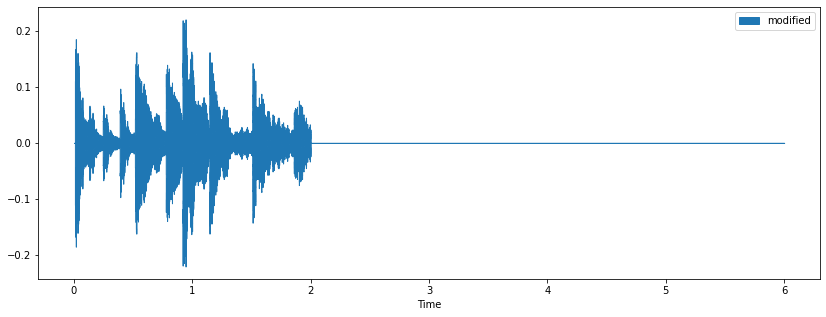

In [145]:
plt.figure(figsize=(14, 5))
librosa.display.waveshow(new_yshort, sr=sr_short, label='modified')
plt.legend()
plt.savefig('waveform.png')

In [147]:
mfccs_new = features.calculate_mfccs(new_yshort, sr_short)
print(mfccs_new.shape)
mfccs_new

(20, 259)


array([[-180.50008  , -133.06564  , -157.84396  , ..., -653.964    ,
        -653.964    , -653.964    ],
       [  91.65564  ,   78.652985 ,   53.279358 , ...,    0.       ,
           0.       ,    0.       ],
       [   8.462153 ,    2.1509645,   -8.783014 , ...,    0.       ,
           0.       ,    0.       ],
       ...,
       [   1.0377003,   -2.750987 ,   -7.8109035, ...,    0.       ,
           0.       ,    0.       ],
       [  -2.5656946,   -4.7207336,   -7.21966  , ...,    0.       ,
           0.       ,    0.       ],
       [   1.2630225,    3.5597308,    3.5293365, ...,    0.       ,
           0.       ,    0.       ]], dtype=float32)

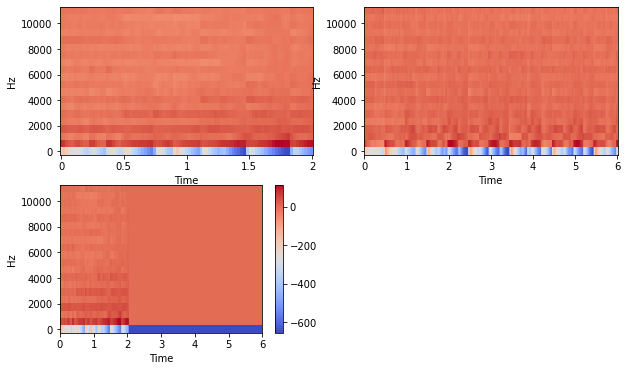

In [149]:
plt.figure(figsize=(10,6))
plt.subplot(2, 2, 1)
librosa.display.specshow(mfccs_short, sr=sr_short, x_axis='time', y_axis='hz')
plt.subplot(2, 2, 2)
librosa.display.specshow(mfccs_long, sr=sr_long, x_axis='time', y_axis='hz')
plt.subplot(2, 2, 3)
librosa.display.specshow(mfccs_new, sr=sr_short, x_axis='time', y_axis='hz')
plt.colorbar()

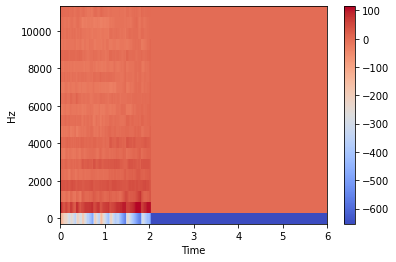

In [150]:

librosa.display.specshow(mfccs_new, sr=sr_short, x_axis='time', y_axis='hz')
plt.colorbar()

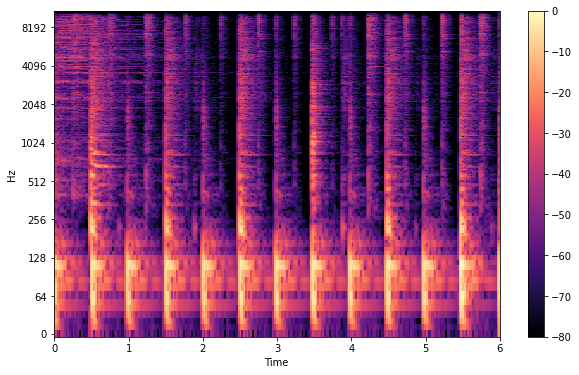

In [152]:
n_fft = 2048
hop_length = 512
plt.figure(figsize=(10,6))
plt.subplot()
D = np.abs(librosa.stft(y_long, n_fft=n_fft, hop_length=hop_length))
DB = librosa.amplitude_to_db(D, ref=np.max)
plt.figure(figsize=(10,6))
librosa.display.specshow(DB, sr=sr_long, hop_length=hop_length, x_axis='time', y_axis='log')
# plt.title(drumbeat)
plt.colorbar()




In [ ]:
D = np.abs(librosa.stft(y, n_fft=n_fft, hop_length=hop_length))
DB = librosa.amplitude_to_db(D, ref=np.max)
plt.figure(figsize=(10,6))
librosa.display.specshow(DB, sr=sr, hop_length=hop_length, x_axis='time', y_axis='log')
plt.title(drumbeat)
plt.colorbar()
plt.savefig('spectrogram.png')

## Features 
### Mel Frequency Cepstral Coefficients (MFCCS) 

In [16]:
def calculate_mfccs(waveform, samplingrate, number_coeffs=20):
    '''
    Caluculate Mel frequency cepstral coefficients.
    Input: 
    waveform: array representing the waveform originating from audio file
    samplingrate: sampling rate from audio
    number_coeffs: total number of coefficients to calculate, default is 20
    Output: array of mfccs
    '''
    mfccs = librosa.feature.mfcc(y=waveform, sr=samplingrate, n_mfcc=number_coeffs)
    return mfccs

In [17]:
coeffs_number = 20
mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=coeffs_number)

In [18]:
mfccs.shape

(20, 4799)

In [19]:
calculate_mfccs(y, sr, coeffs_number).shape

(20, 4799)

In [20]:
np.all(calculate_mfccs(y, sr, coeffs_number) == mfccs)

True

In [61]:
y.shape

(2457000,)

### Zero crossing rate

In [34]:
def calculate_zerocrossrate(waveform, framelength=2048, hoplength=512,):
    '''
    Caluculate Zero crossing rate.

    '''
    zerocr = librosa.feature.zero_crossing_rate(y, frame_length=framelength, hop_length=hoplength)
    
    return zerocr

In [68]:
calculate_zerocrossrate(y).shape

(1, 4799)

In [69]:
calculate_zerocrossrate(y)

array([[0.05029297, 0.09619141, 0.11572266, ..., 0.45458984, 0.43066406,
        0.31591797]])

In [70]:
y

array([ 0.0000000e+00,  0.0000000e+00,  0.0000000e+00, ...,
       -4.9928343e-04,  7.1120521e-06,  4.0293275e-04], dtype=float32)

In [72]:
calculate_zerocrossrate(y2, sr2).shape

(1, 4799)

### Spectral Centroid

In [30]:
def calculate_spectralcentroid(waveform, samplingrate, nfft=2048, hoplength=512):
    '''
    Calculate spectral centroid
    '''
    specent = librosa.feature.spectral_centroid(y=waveform, sr=samplingrate, n_fft=nfft, hop_length=hoplength)
    
    return specent

In [23]:
calculate_spectralcentroid(y, sr)

array([[2584.22073267, 2576.24466302, 3082.18746615, ..., 5298.29883182,
        5204.9787199 , 5237.79159149]])

### Spectral Bandwith

In [24]:
def calculate_specbandwidth(waveform, samplingrate, order_p=2):
    '''
    Calculates spectral bandwithd of oder p
    '''
    specbw = librosa.feature.spectral_bandwidth(y=waveform, sr=samplingrate, p=order_p)
    
    return specbw

In [25]:
calculate_specbandwidth(y, sr)

array([[3363.35423315, 3450.05572744, 3656.02510445, ..., 2768.29906585,
        2764.84165971, 2755.50559619]])

### Chroma Feature

In [32]:
def calculate_chroma(waveform, samplingrate, nfft=2048, hoplength=512):
    '''
    Chroma Feature calculation with a hop length of 512 as default
    
    '''
    chromafeat = librosa.feature.chroma_stft(y=waveform, sr=samplingrate, n_fft=nfft, hop_length=hoplength)
    
    return chromafeat

In [33]:
calculate_chroma(y, sr)

array([[0.7654034 , 0.6846577 , 0.60380507, ..., 0.66754496, 0.63650644,
        0.49084777],
       [0.68031585, 0.64917874, 0.57817703, ..., 0.60784036, 0.6902995 ,
        0.52589965],
       [0.65420556, 0.6909549 , 0.6417953 , ..., 0.5743292 , 0.9394343 ,
        0.73959804],
       ...,
       [1.        , 0.98273236, 0.8690368 , ..., 0.76361066, 0.88450366,
        0.6906826 ],
       [0.9577081 , 0.91597515, 0.79983085, ..., 0.86568844, 1.        ,
        1.        ],
       [0.82971966, 0.76867723, 0.6664979 , ..., 0.37880915, 0.41392168,
        0.32937646]], dtype=float32)

In [75]:
calculate_chroma(y, sr).shape

(12, 4799)

In [76]:
calculate_chroma(y2, sr2).shape

(12, 9583)

### Spectral roll off

In [36]:
def calculate_spectralroff(waveform, samplingrate, nfft=2048, hoplength=512):
    '''
    Calculate spectral roll off of the waveform
    '''
    specroff = librosa.feature.spectral_rolloff(y=waveform, sr=samplingrate, n_fft=nfft, hop_length=hoplength)
    
    return specroff

In [37]:
calculate_spectralroff(y, sr)

array([[7342.82226562, 7568.92089844, 8247.21679688, ..., 8516.38183594,
        8451.78222656, 8537.91503906]])

In [59]:
features.calculate_spectralcentroid(y, sr)

array([[2584.22073267, 2576.24466302, 3082.18746615, ..., 5298.29883182,
        5204.9787199 , 5237.79159149]])

### Spectrograms 

In [84]:
def reading_in_audio(audiofile_path, samplingrate=22050, duration=None):
    '''
    Reading in audiofile, returns 1-dimensional array x, sampling rate sr
    '''

    x , sr = librosa.load(audiofile_path, sr=samplingrate, duration=duration)
    return x, sr


def spectogram(waveform, samplingrate):
    '''
    ===  1 Spectogram  ===
    requires 1-dimensional array x(timeseries), sampling rate sr
    returns spectogram, a matplotlib.colormesh object

    '''

    #performing short time- Fourier analysis
    X = librosa.stft(waveform, samplingrate)

    #amplitudes of given frequency at given time -> spectrogram
    Xdb = librosa.amplitude_to_db(abs(X))

    #plt.figure(figsize=(6, 5), frameon=False)
    #librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz') # for demonstration purposes
    
    spectogram = librosa.display.specshow(Xdb, sr=sr, x_axis=None, y_axis=None) # without axes
    
    return spectogram 


# def mfcc(x, sr):
# #  ==== 2 Mel Frequency Cepstral Coefficients (MFCCs) ===
# #  requires 1-dimensional array x(timeseries), sampling rate sr
# # returns mfcc, a matplotlib.colormesh object

#     mfccs = librosa.feature.mfcc(y=x, sr=sr)

#     plt.figure(figsize=(6, 5))
#     mfcc = librosa.display.specshow(mfccs, sr=sr, x_axis='time')
    
#     return 


/var/folders/jw/d43bpk916bz864ddr7_d7nqh0000gp/T/ipykernel_16229/1053342961.py:19: FutureWarning: Pass n_fft=22050 as keyword args. From version 0.10 passing these as positional arguments will result in an error
  X = librosa.stft(waveform, samplingrate)


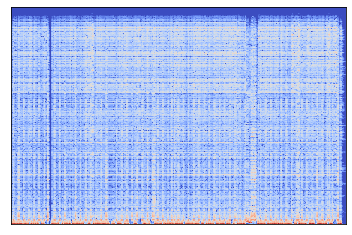

In [85]:
spectogram(y, sr)